In [2]:
from dm_control import suite
import numpy as np

# Load a simple environment
env = suite.load(domain_name="cartpole", task_name="balance")

# Reset environment
time_step = env.reset()
print("Observation shape:", time_step.observation)

# Take a random action
action = np.random.uniform(-1, 1, size=env.action_spec().shape)
time_step = env.step(action)
print("Step successful!")

# Try rendering (this will be slow without GPU but should work)
pixels = env.physics.render(width=480, height=320, camera_id=0)
print("Rendering shape:", pixels.shape)
print("Setup successful!")

Observation shape: OrderedDict([('position', array([-0.08505757,  0.99999923,  0.00124055])), ('velocity', array([0.0005798 , 0.00474067]))])
Step successful!
Rendering shape: (320, 480, 3)
Setup successful!


In [6]:
from dm_control import suite
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# Load environment
env = suite.load("walker", "walk")

# Run a few steps
time_step = env.reset()
frames = []

for _ in range(100):
    action = env.action_spec().generate_value()
    time_step = env.step(action)
    
    # Render frame (reduce size for better performance)
    frame = env.physics.render(width=140, height=100)
    frames.append(frame)

# Display a frame
# plt.imshow(frames[50])
# plt.axis('off')
# plt.show()

# Create an animation from the frames
fig = plt.figure()
ax = plt.axes()
ax.axis('off')
im = ax.imshow(frames[0])

def animate(i):
    im.set_array(frames[i])
    return [im]

anim = animation.FuncAnimation(fig, animate, frames=len(frames), interval=60, blit=True)

# Display the animation as HTML
plt.close(anim._fig)
HTML(anim.to_jshtml())

Initial observation keys: odict_keys(['position', 'velocity'])
Reward spec: Array(shape=(), dtype=dtype('float64'), name='reward')
Action spec: BoundedArray(shape=(1,), dtype=dtype('float64'), name=None, minimum=[-1.], maximum=[1.])
Step 0: Action=0.165, Reward=0.993, Done=False
Step 1: Action=0.157, Reward=0.993, Done=False
Step 2: Action=0.149, Reward=0.993, Done=False
Step 3: Action=0.141, Reward=0.994, Done=False
Step 4: Action=0.133, Reward=0.994, Done=False
Step 5: Action=0.125, Reward=0.994, Done=False
Step 6: Action=0.117, Reward=0.994, Done=False
Step 7: Action=0.110, Reward=0.994, Done=False
Step 8: Action=0.102, Reward=0.994, Done=False
Step 9: Action=0.095, Reward=0.994, Done=False
Step 10: Action=0.088, Reward=0.994, Done=False
Step 11: Action=0.081, Reward=0.994, Done=False
Step 12: Action=0.074, Reward=0.994, Done=False
Step 13: Action=0.068, Reward=0.994, Done=False
Step 14: Action=0.061, Reward=0.994, Done=False
Step 15: Action=0.055, Reward=0.993, Done=False
Step 16: 

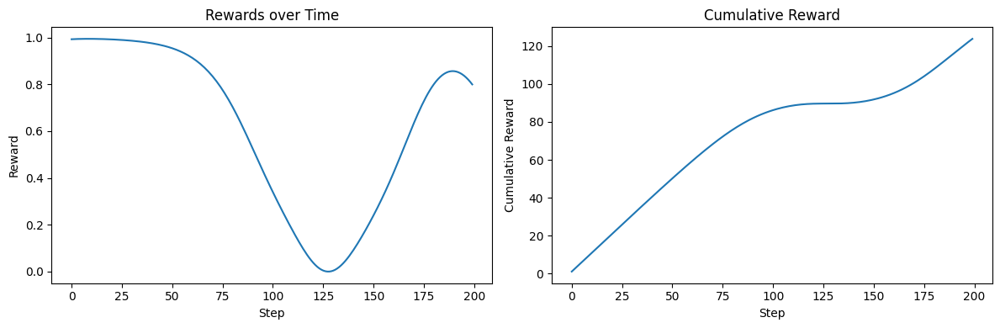

Total reward: 123.890
Average reward: 0.619


In [7]:
from dm_control import suite
import numpy as np
import matplotlib.pyplot as plt

# Load environment with a task that has clear rewards
env = suite.load(domain_name="cartpole", task_name="balance")

# Reset environment and get initial observation
time_step = env.reset()
print("Initial observation keys:", time_step.observation.keys())
print("Reward spec:", env.reward_spec())
print("Action spec:", env.action_spec())

# Run episode with different action strategies
episode_length = 200
rewards = []
observations = []

for step in range(episode_length):
    # Get current observation
    obs = time_step.observation
    observations.append(obs)
    
    # Strategy 1: Random action
    # action = np.random.uniform(env.action_spec().minimum, 
    #                           env.action_spec().maximum, 
    #                           size=env.action_spec().shape)
    
    # Strategy 2: Simple policy based on observation
    # For cartpole, try to balance by controlling force based on angle
    if 'position' in obs and 'velocity' in obs:
        angle = obs['position'][0] if len(obs['position']) > 0 else 0
        angular_vel = obs['velocity'][0] if len(obs['velocity']) > 0 else 0
        # Simple proportional control
        action = np.array([-2.0 * angle - 0.5 * angular_vel])
        # Clip to action bounds
        action = np.clip(action, env.action_spec().minimum, env.action_spec().maximum)
    else:
        action = np.random.uniform(env.action_spec().minimum, 
                                 env.action_spec().maximum, 
                                 size=env.action_spec().shape)
    
    # Take action and get next state
    time_step = env.step(action)
    
    # Extract reward and other information
    reward = time_step.reward
    done = time_step.last()  # Episode termination
    
    rewards.append(reward)
    
    print(f"Step {step}: Action={action[0]:.3f}, Reward={reward:.3f}, Done={done}")
    
    if done:
        print("Episode terminated!")
        break

# Plot rewards over time
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(rewards)
plt.title('Rewards over Time')
plt.xlabel('Step')
plt.ylabel('Reward')

plt.subplot(1, 2, 2)
plt.plot(np.cumsum(rewards))
plt.title('Cumulative Reward')
plt.xlabel('Step')
plt.ylabel('Cumulative Reward')

plt.tight_layout()
plt.show()

print(f"Total reward: {sum(rewards):.3f}")
print(f"Average reward: {np.mean(rewards):.3f}")

In [8]:
def run_episode_with_policy(env, policy_fn, max_steps=1000):
    """Run a complete episode with a given policy function."""
    time_step = env.reset()
    total_reward = 0
    step_count = 0
    
    while not time_step.last() and step_count < max_steps:
        # Get action from policy
        action = policy_fn(time_step.observation)
        
        # Take step
        time_step = env.step(action)
        total_reward += time_step.reward
        step_count += 1
    
    return total_reward, step_count

# Example policies
def random_policy(observation):
    """Random action policy."""
    return env.action_spec().generate_value()

def balance_policy(observation):
    """Simple balancing policy for cartpole."""
    if 'position' in observation and 'velocity' in observation:
        angle = observation['position'][0] if len(observation['position']) > 0 else 0
        angular_vel = observation['velocity'][0] if len(observation['velocity']) > 0 else 0
        action = np.array([-3.0 * angle - 1.0 * angular_vel])
        return np.clip(action, env.action_spec().minimum, env.action_spec().maximum)
    return env.action_spec().generate_value()

# Test different policies
env = suite.load("cartpole", "balance")

print("Testing Random Policy:")
total_reward, steps = run_episode_with_policy(env, random_policy)
print(f"Total reward: {total_reward:.3f}, Steps: {steps}")

print("\nTesting Balance Policy:")
total_reward, steps = run_episode_with_policy(env, balance_policy)
print(f"Total reward: {total_reward:.3f}, Steps: {steps}")

Testing Random Policy:
Total reward: 135.042, Steps: 1000

Testing Balance Policy:
Total reward: 373.499, Steps: 1000


Training Actor-Critic on CartPole Balance...
Observation dim: 5, Action dim: 1


/var/folders/m7/qwn6drh54m1_9m7fsgsf1t680000gn/T/ipykernel_28722/145319149.py:100: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at /Users/runner/work/pytorch/pytorch/pytorch/torch/csrc/utils/tensor_new.cpp:257.)
  'observations': torch.FloatTensor(observations),


Episode 0, Avg Reward: 192.27, Avg Length: 1000.0
  Actor Loss: -0.5564, Critic Loss: 25.6102, Entropy: 1.4189
Episode 10, Avg Reward: 159.73, Avg Length: 1000.0
  Actor Loss: -1.2323, Critic Loss: 12.2102, Entropy: 1.4162
Episode 20, Avg Reward: 165.09, Avg Length: 1000.0
  Actor Loss: 493.2121, Critic Loss: 8.4701, Entropy: 1.4165
Episode 30, Avg Reward: 153.48, Avg Length: 1000.0
  Actor Loss: 1334.6558, Critic Loss: 6.9596, Entropy: 1.4194
Episode 40, Avg Reward: 149.07, Avg Length: 1000.0
  Actor Loss: 2507.7100, Critic Loss: 7.1664, Entropy: 1.4231
Episode 50, Avg Reward: 142.66, Avg Length: 1000.0
  Actor Loss: 3402.5447, Critic Loss: 5.5016, Entropy: 1.4270
Episode 60, Avg Reward: 140.45, Avg Length: 1000.0
  Actor Loss: 5383.1685, Critic Loss: 5.6291, Entropy: 1.4308
Episode 70, Avg Reward: 138.25, Avg Length: 1000.0
  Actor Loss: 8391.6055, Critic Loss: 5.1951, Entropy: 1.4344
Episode 80, Avg Reward: 137.07, Avg Length: 1000.0
  Actor Loss: 10636.3838, Critic Loss: 4.3535, En

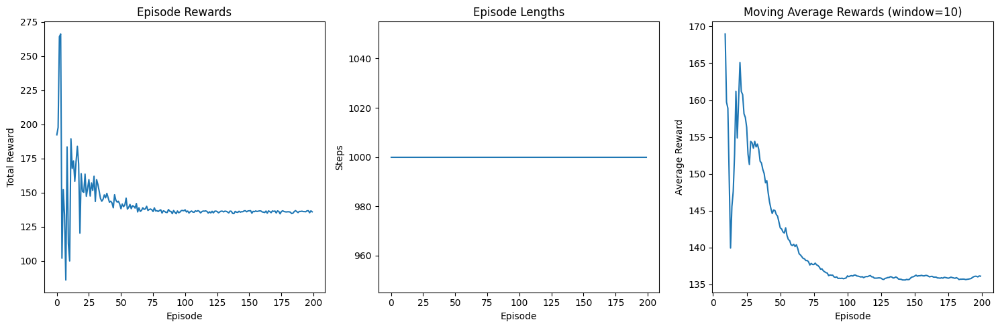

Final average reward (last 20 episodes): 135.91


In [9]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.distributions import Normal
import numpy as np
import matplotlib.pyplot as plt
from collections import deque
from dm_control import suite

class ActorCritic(nn.Module):
    def __init__(self, obs_dim, action_dim, hidden_dim=128):
        super(ActorCritic, self).__init__()
        
        # Shared layers
        self.shared = nn.Sequential(
            nn.Linear(obs_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU()
        )
        
        # Actor head (policy network)
        self.actor_mean = nn.Linear(hidden_dim, action_dim)
        self.actor_log_std = nn.Parameter(torch.zeros(action_dim))
        
        # Critic head (value network)
        self.critic = nn.Linear(hidden_dim, 1)
        
    def forward(self, obs):
        shared_features = self.shared(obs)
        
        # Actor outputs
        action_mean = self.actor_mean(shared_features)
        action_std = torch.exp(self.actor_log_std)
        
        # Critic output
        value = self.critic(shared_features)
        
        return action_mean, action_std, value
    
    def get_action(self, obs):
        action_mean, action_std, value = self.forward(obs)
        dist = Normal(action_mean, action_std)
        action = dist.sample()
        log_prob = dist.log_prob(action).sum(dim=-1)
        return action, log_prob, value

def flatten_observation(obs_dict):
    """Flatten MuJoCo observation dictionary into a single vector."""
    obs_list = []
    for key in sorted(obs_dict.keys()):
        obs_array = obs_dict[key]
        if obs_array.ndim == 0:
            obs_list.append([obs_array])
        else:
            obs_list.append(obs_array.flatten())
    return np.concatenate(obs_list)

def collect_trajectory(env, policy, max_steps=1000):
    """Collect a single trajectory using the current policy."""
    time_step = env.reset()
    
    observations = []
    actions = []
    rewards = []
    log_probs = []
    values = []
    dones = []
    
    step_count = 0
    
    while not time_step.last() and step_count < max_steps:
        # Convert observation to tensor
        obs_flat = flatten_observation(time_step.observation)
        obs_tensor = torch.FloatTensor(obs_flat).unsqueeze(0)
        
        # Get action from policy
        with torch.no_grad():
            action, log_prob, value = policy.get_action(obs_tensor)
        
        # Convert action to numpy and clip to bounds
        action_np = action.squeeze().numpy()
        action_np = np.clip(action_np, env.action_spec().minimum, env.action_spec().maximum)
        
        # Store experience
        observations.append(obs_flat)
        actions.append(action.squeeze())
        log_probs.append(log_prob)
        values.append(value.squeeze())
        
        # Take step in environment
        time_step = env.step(action_np)
        rewards.append(time_step.reward)
        dones.append(time_step.last())
        
        step_count += 1
    
    return {
        'observations': torch.FloatTensor(observations),
        'actions': torch.stack(actions),
        'rewards': torch.FloatTensor(rewards),
        'log_probs': torch.stack(log_probs),
        'values': torch.stack(values),
        'dones': torch.BoolTensor(dones)
    }

def compute_advantages(rewards, values, dones, gamma=0.99, lambda_gae=0.95):
    """Compute Generalized Advantage Estimation (GAE)."""
    advantages = torch.zeros_like(rewards)
    returns = torch.zeros_like(rewards)
    
    gae = 0
    next_value = 0
    
    for t in reversed(range(len(rewards))):
        if dones[t]:
            next_value = 0
            gae = 0
        
        delta = rewards[t] + gamma * next_value - values[t]
        gae = delta + gamma * lambda_gae * gae
        advantages[t] = gae
        returns[t] = gae + values[t]
        next_value = values[t]
    
    return advantages, returns

def train_actor_critic():
    # Environment setup
    env = suite.load("cartpole", "balance")
    
    # Get observation and action dimensions
    time_step = env.reset()
    obs_flat = flatten_observation(time_step.observation)
    obs_dim = len(obs_flat)
    action_dim = env.action_spec().shape[0]
    
    print(f"Observation dim: {obs_dim}, Action dim: {action_dim}")
    
    # Initialize policy
    policy = ActorCritic(obs_dim, action_dim, hidden_dim=128)
    optimizer = optim.Adam(policy.parameters(), lr=3e-4)
    
    # Training parameters
    num_episodes = 200
    gamma = 0.99
    lambda_gae = 0.95
    
    # Tracking
    episode_rewards = []
    episode_lengths = []
    
    for episode in range(num_episodes):
        # Collect trajectory
        trajectory = collect_trajectory(env, policy, max_steps=1000)
        
        # Compute advantages and returns
        advantages, returns = compute_advantages(
            trajectory['rewards'], 
            trajectory['values'], 
            trajectory['dones'], 
            gamma, 
            lambda_gae
        )
        
        # Normalize advantages
        advantages = (advantages - advantages.mean()) / (advantages.std() + 1e-8)
        
        # Compute policy loss
        action_mean, action_std, new_values = policy(trajectory['observations'])
        dist = Normal(action_mean, action_std)
        new_log_probs = dist.log_prob(trajectory['actions']).sum(dim=-1)
        
        # Actor loss (policy gradient)
        actor_loss = -(new_log_probs * advantages).mean()
        
        # Critic loss (value function)
        critic_loss = F.mse_loss(new_values.squeeze(), returns)
        
        # Entropy bonus for exploration
        entropy = dist.entropy().sum(dim=-1).mean()
        entropy_bonus = 0.01 * entropy
        
        # Total loss
        total_loss = actor_loss + 0.5 * critic_loss - entropy_bonus
        
        # Update policy
        optimizer.zero_grad()
        total_loss.backward()
        torch.nn.utils.clip_grad_norm_(policy.parameters(), 0.5)
        optimizer.step()
        
        # Tracking
        episode_reward = trajectory['rewards'].sum().item()
        episode_length = len(trajectory['rewards'])
        episode_rewards.append(episode_reward)
        episode_lengths.append(episode_length)
        
        if episode % 10 == 0:
            avg_reward = np.mean(episode_rewards[-10:])
            avg_length = np.mean(episode_lengths[-10:])
            print(f"Episode {episode}, Avg Reward: {avg_reward:.2f}, Avg Length: {avg_length:.1f}")
            print(f"  Actor Loss: {actor_loss:.4f}, Critic Loss: {critic_loss:.4f}, Entropy: {entropy:.4f}")
    
    return policy, episode_rewards, episode_lengths

# Train the policy
print("Training Actor-Critic on CartPole Balance...")
trained_policy, rewards, lengths = train_actor_critic()

# Plot training progress
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.plot(rewards)
plt.title('Episode Rewards')
plt.xlabel('Episode')
plt.ylabel('Total Reward')

plt.subplot(1, 3, 2)
plt.plot(lengths)
plt.title('Episode Lengths')
plt.xlabel('Episode')
plt.ylabel('Steps')

plt.subplot(1, 3, 3)
# Moving average of rewards
window = 10
moving_avg = np.convolve(rewards, np.ones(window)/window, mode='valid')
plt.plot(range(window-1, len(rewards)), moving_avg)
plt.title(f'Moving Average Rewards (window={window})')
plt.xlabel('Episode')
plt.ylabel('Average Reward')

plt.tight_layout()
plt.show()

print(f"Final average reward (last 20 episodes): {np.mean(rewards[-20:]):.2f}")

Test Episode 1: Reward = 136.63, Length = 1000
Test Episode 2: Reward = 135.47, Length = 1000
Test Episode 3: Reward = 135.83, Length = 1000
Test Episode 4: Reward = 134.33, Length = 1000
Test Episode 5: Reward = 135.96, Length = 1000

Test Results:
Average Reward: 135.64 ± 0.76
Average Length: 1000.0 ± 0.0

Creating video of policy performance...
Recording policy performance...
Recorded 50 frames...
Recorded 100 frames...
Recorded 150 frames...
Recorded 200 frames...
Recorded 250 frames...
Recorded 300 frames...
Recorded 300 frames total
Total reward: 50.38
Average reward per step: 0.168


/var/folders/m7/qwn6drh54m1_9m7fsgsf1t680000gn/T/ipykernel_28722/331055907.py:109: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax3.set_ylim(min(actions) * 1.1, max(actions) * 1.1)


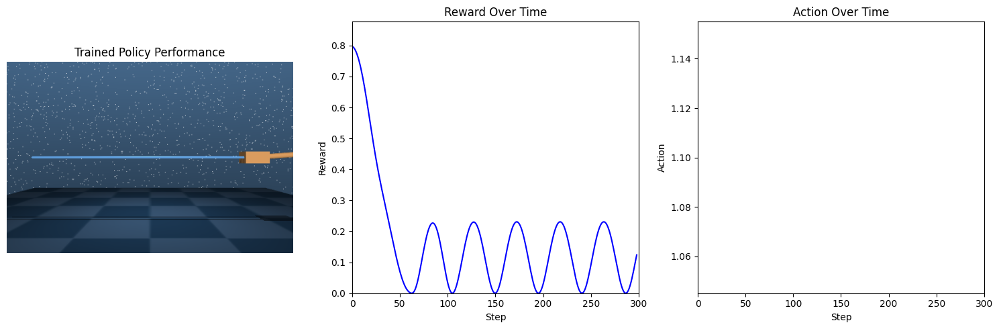

In [11]:
def test_trained_policy(policy, env, num_episodes=5):
    """Test the trained policy and visualize performance."""
    test_rewards = []
    test_lengths = []
    
    for episode in range(num_episodes):
        time_step = env.reset()
        total_reward = 0
        step_count = 0
        
        rewards_episode = []
        
        while not time_step.last() and step_count < 1000:
            # Get observation
            obs_flat = flatten_observation(time_step.observation)
            obs_tensor = torch.FloatTensor(obs_flat).unsqueeze(0)
            
            # Get action from trained policy
            with torch.no_grad():
                action, _, _ = policy.get_action(obs_tensor)
            
            # Convert and clip action
            action_np = action.squeeze().numpy()
            action_np = np.clip(action_np, env.action_spec().minimum, env.action_spec().maximum)
            
            # Take step
            time_step = env.step(action_np)
            total_reward += time_step.reward
            rewards_episode.append(time_step.reward)
            step_count += 1
        
        test_rewards.append(total_reward)
        test_lengths.append(step_count)
        
        print(f"Test Episode {episode + 1}: Reward = {total_reward:.2f}, Length = {step_count}")
    
    print(f"\nTest Results:")
    print(f"Average Reward: {np.mean(test_rewards):.2f} ± {np.std(test_rewards):.2f}")
    print(f"Average Length: {np.mean(test_lengths):.1f} ± {np.std(test_lengths):.1f}")
    
    return test_rewards, test_lengths

def create_policy_video(policy, env, episode_length=500, width=480, height=320):
    """Create a video of the policy performance."""
    import matplotlib.animation as animation
    from IPython.display import HTML
    
    # Reset environment
    time_step = env.reset()
    
    # Collect frames and data
    frames = []
    rewards = []
    actions = []
    step_count = 0
    
    print("Recording policy performance...")
    
    while not time_step.last() and step_count < episode_length:
        # Render frame
        frame = env.physics.render(width=width, height=height, camera_id=0)
        frames.append(frame)
        
        # Get observation
        obs_flat = flatten_observation(time_step.observation)
        obs_tensor = torch.FloatTensor(obs_flat).unsqueeze(0)
        
        # Get action from trained policy
        with torch.no_grad():
            action, _, _ = policy.get_action(obs_tensor)
        
        # Convert and clip action
        action_np = action.squeeze().numpy()
        action_np = np.clip(action_np, env.action_spec().minimum, env.action_spec().maximum)
        actions.append(action_np[0])
        
        # Take step
        time_step = env.step(action_np)
        rewards.append(time_step.reward)
        step_count += 1
        
        if step_count % 50 == 0:
            print(f"Recorded {step_count} frames...")
    
    print(f"Recorded {len(frames)} frames total")
    print(f"Total reward: {sum(rewards):.2f}")
    print(f"Average reward per step: {np.mean(rewards):.3f}")
    
    # Create animation
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))
    
    # Main video display
    ax1.set_title('Trained Policy Performance')
    ax1.axis('off')
    im = ax1.imshow(frames[0])
    
    # Reward plot
    ax2.set_title('Reward Over Time')
    ax2.set_xlabel('Step')
    ax2.set_ylabel('Reward')
    ax2.set_ylim(0, max(rewards) * 1.1 if rewards else 1)
    ax2.set_xlim(0, len(rewards))
    reward_line, = ax2.plot([], [], 'b-')
    
    # Action plot
    ax3.set_title('Action Over Time')
    ax3.set_xlabel('Step')
    ax3.set_ylabel('Action')
    ax3.set_ylim(min(actions) * 1.1, max(actions) * 1.1)
    ax3.set_xlim(0, len(actions))
    action_line, = ax3.plot([], [], 'r-')
    
    def animate(frame_idx):
        # Update main video
        im.set_array(frames[frame_idx])
        
        # Update reward plot
        if frame_idx > 0:
            reward_line.set_data(range(frame_idx), rewards[:frame_idx])
            action_line.set_data(range(frame_idx), actions[:frame_idx])
        
        return [im, reward_line, action_line]
    
    # Create animation
    anim = animation.FuncAnimation(
        fig, animate, frames=len(frames), 
        interval=50, blit=True, repeat=True
    )
    
    plt.tight_layout()
    
    # Display in notebook
    return HTML(anim.to_jshtml())

# Test the trained policy
env = suite.load("cartpole", "balance")
test_rewards, test_lengths = test_trained_policy(trained_policy, env)

# Create and display video
print("\nCreating video of policy performance...")
video_html = create_policy_video(trained_policy, env, episode_length=300)
video_html